### Importing road augmentation library Automold and helper functions library

In [2]:

# import glob
import cv2 as cv2
import numpy as np
# import matplotlib.pyplot as plt
import random
import math


###################### HLS #############################

def hls(image,src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_HLS=[]
        image_list=image
        for img in image_list:
            eval('image_HLS.append(cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2HLS))')
    else:
        image_HLS = eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2HLS)')
    return image_HLS

def hue(image,src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_Hue=[]
        image_list=image
        for img in image_list:
            image_Hue.append(hls(img,src)[:,:,0])
    else:
        image_Hue= hls(image,src)[:,:,0]
    return image_Hue

def lightness(image,src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_lightness=[]
        image_list=image
        for img in image_list:
            image_lightness.append(hls(img,src)[:,:,1])
    else:
        image_lightness= hls(image,src)[:,:,1]
    return image_lightness

def saturation(image,src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_saturation=[]
        image_list=image
        for img in image_list:
            image_saturation.append(hls(img,src)[:,:,2])
    else:
        image_saturation= hls(image,src)[:,:,2]
    return image_saturation

###################### HSV #############################

def hsv(image,src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_HSV=[]
        image_list=image
        for img in image_list:
            eval('image_HSV.append(cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2HSV))')
    else:
        image_HSV = eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2HSV)')
    return image_HSV

def value(image,src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_value=[]
        image_list=image
        for img in image_list:
            image_value.append(hsv(img,src)[:,:,2])
    else:
        image_value= hsv(image,src)[:,:,2]
    return image_value

###################### BGR #############################

def bgr(image, src='RGB'):
    verify_image(image)
    if(is_list(image)):
        image_BGR=[]
        image_list=image
        for img in image_list:
            eval('image_BGR.append(cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2BGR))')
    else:
        image_BGR= eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2BGR)')
    return image_BGR

###################### RGB #############################
def rgb(image, src='BGR'):
    verify_image(image)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            eval('image_RGB.append(cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2RGB))')
    else:
        image_RGB= eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2RGB)')
    return image_RGB

def red(image,src='BGR'):
    verify_image(image)
    if(is_list(image)):
        image_red=[]
        image_list=image
        for img in image_list:
            i= eval('cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2RGB)')
            image_red.append(i[:,:,0])
    else:
        image_red= eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2RGB)[:,:,0]')
    return image_red

def green(image,src='BGR'):
    verify_image(image)
    if(is_list(image)):
        image_green=[]
        image_list=image
        for img in image_list:
            i= eval('cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2RGB)')
            image_green.append(i[:,:,1])
    else:
        image_green= eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2RGB)[:,:,1]')
    return image_green

def blue(image,src='BGR'):
    verify_image(image)
    if(is_list(image)):
        image_blue=[]
        image_list=image
        for img in image_list:
            i=eval('cv2.cvtColor(img,cv2.COLOR_'+src.upper()+'2RGB)')
            image_blue.append(i[:,:,2])
    else:
        image_blue= eval('cv2.cvtColor(image,cv2.COLOR_'+src.upper()+'2RGB)[:,:,2]')
    return image_blue

err_not_np_img= "not a numpy array or list of numpy array"
err_img_arr_empty="Image array is empty"
err_row_zero="No. of rows can't be <=0"
err_column_zero="No. of columns can't be <=0"
err_invalid_size="Not a valid size tuple (x,y)"
err_caption_array_count="Caption array length doesn't matches the image array length"

def is_numpy_array(x):

    return isinstance(x, np.ndarray)
def is_tuple(x):
    return type(x) is tuple
def is_list(x):
    return type(x) is list
def is_numeric(x):
    return type(x) is int
def is_numeric_list_or_tuple(x):
    for i in x:
        if not is_numeric(i):
            return False
    return True

err_brightness_coeff="brightness coeff can only be between 0.0 to 1.0"
err_darkness_coeff="darkness coeff can only be between 0.0 to 1.0"

def change_light(image, coeff):
    image_HLS = cv2.cvtColor(image,cv2.COLOR_RGB2HLS) ## Conversion to HLS
    image_HLS = np.array(image_HLS, dtype = np.float64)
    image_HLS[:,:,1] = image_HLS[:,:,1]*coeff ## scale pixel values up or down for channel 1(Lightness)
    if(coeff>1):
        image_HLS[:,:,1][image_HLS[:,:,1]>255]  = 255 ##Sets all values above 255 to 255
    else:
        image_HLS[:,:,1][image_HLS[:,:,1]<0]=0
    image_HLS = np.array(image_HLS, dtype = np.uint8)
    image_RGB = cv2.cvtColor(image_HLS,cv2.COLOR_HLS2RGB) ## Conversion to RGB
    return image_RGB

def verify_image(image):
    if is_numpy_array(image):
        pass
    elif(is_list(image)):
        image_list=image
        for img in image_list:
            if not is_numpy_array(img):
                raise Exception(err_not_np_img)
    else:
        raise Exception(err_not_np_img)

def brighten(image, brightness_coeff=-1): ##function to brighten the image
    verify_image(image)
    if(brightness_coeff!=-1):
        if(brightness_coeff<0.0 or brightness_coeff>1.0):
            raise Exception(err_brightness_coeff)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            if(brightness_coeff==-1):
                brightness_coeff_t=1+ random.uniform(0,1) ## coeff between 1.0 and 1.5
            else:
                brightness_coeff_t=1+ brightness_coeff ## coeff between 1.0 and 2.0
            image_RGB.append(change_light(img,brightness_coeff_t))
    else:
        if(brightness_coeff==-1):
            brightness_coeff_t=1+ random.uniform(0,1) ## coeff between 1.0 and 1.5
        else:
            brightness_coeff_t=1+ brightness_coeff ## coeff between 1.0 and 2.0
        image_RGB= change_light(image,brightness_coeff_t)
    return image_RGB

def darken(image, darkness_coeff=-1): ##function to darken the image
    verify_image(image)
    if(darkness_coeff!=-1):
        if(darkness_coeff<0.0 or darkness_coeff>1.0):
            raise Exception(err_darkness_coeff)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            if(darkness_coeff==-1):
                darkness_coeff_t=1- random.uniform(0,1)
            else:
                darkness_coeff_t=1- darkness_coeff
            image_RGB.append(change_light(img,darkness_coeff_t))
    else:
        if(darkness_coeff==-1):
             darkness_coeff_t=1- random.uniform(0,1)
        else:
            darkness_coeff_t=1- darkness_coeff
        image_RGB= change_light(image,darkness_coeff_t)
    return image_RGB


def random_brightness(image):
    verify_image(image)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            random_brightness_coefficient = 2* np.random.uniform(0,1) ## generates value between 0.0 and 2.0
            image_RGB.append(change_light(img,random_brightness_coefficient))
    else:
        random_brightness_coefficient = 2* np.random.uniform(0,1) ## generates value between 0.0 and 2.0
        image_RGB= change_light(image,random_brightness_coefficient)
    return image_RGB

err_shadow_count="only 1-10 shadows can be introduced in an image"
err_invalid_rectangular_roi="Rectangular ROI dimensions are not valid"
err_shadow_dimension="polygons with dim<3 dont exist and >10 take time to plot"

def generate_shadow_coordinates(imshape, no_of_shadows, rectangular_roi, shadow_dimension):
    vertices_list=[]
    x1=rectangular_roi[0]
    y1=rectangular_roi[1]
    x2=rectangular_roi[2]
    y2=rectangular_roi[3]
    for index in range(no_of_shadows):
        vertex=[]
        for dimensions in range(shadow_dimension): ## Dimensionality of the shadow polygon
            vertex.append((random.randint(x1, x2),random.randint(y1, y2)))
        vertices = np.array([vertex], dtype=np.int32) ## single shadow vertices
        vertices_list.append(vertices)
    return vertices_list ## List of shadow vertices

def shadow_process(image,no_of_shadows,x1,y1,x2,y2, shadow_dimension):
    image_HLS = cv2.cvtColor(image,cv2.COLOR_RGB2HLS) ## Conversion to HLS
    mask = np.zeros_like(image)
    imshape = image.shape
    vertices_list= generate_shadow_coordinates(imshape, no_of_shadows,(x1,y1,x2,y2), shadow_dimension) #3 getting list of shadow vertices
    for vertices in vertices_list:
        cv2.fillPoly(mask, vertices, 255) ## adding all shadow polygons on empty mask, single 255 denotes only red channel
    image_HLS[:,:,1][mask[:,:,0]==255] = image_HLS[:,:,1][mask[:,:,0]==255]*0.5   ## if red channel is hot, image's "Lightness" channel's brightness is lowered
    image_RGB = cv2.cvtColor(image_HLS,cv2.COLOR_HLS2RGB) ## Conversion to RGB
    return image_RGB

def add_shadow(image,no_of_shadows=1,rectangular_roi=(-1,-1,-1,-1), shadow_dimension=5):## ROI:(top-left x1,y1, bottom-right x2,y2), shadow_dimension=no. of sides of polygon generated
    verify_image(image)
    if not(is_numeric(no_of_shadows) and no_of_shadows>=1 and no_of_shadows<=10):
        raise Exception(err_shadow_count)
    if not(is_numeric(shadow_dimension) and shadow_dimension>=3 and shadow_dimension<=10):
        raise Exception(err_shadow_dimension)
    if is_tuple(rectangular_roi) and is_numeric_list_or_tuple(rectangular_roi) and len(rectangular_roi)==4:
        x1=rectangular_roi[0]
        y1=rectangular_roi[1]
        x2=rectangular_roi[2]
        y2=rectangular_roi[3]
    else:
        raise Exception(err_invalid_rectangular_roi)
    if rectangular_roi==(-1,-1,-1,-1):
        x1=0

        if(is_numpy_array(image)):
            y1=image.shape[0]//2
            x2=image.shape[1]
            y2=image.shape[0]
        else:
            y1=image[0].shape[0]//2
            x2=image[0].shape[1]
            y2=image[0].shape[0]

    elif x1==-1 or y1==-1 or x2==-1 or y2==-1 or x2<=x1 or y2<=y1:
        raise Exception(err_invalid_rectangular_roi)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            output=shadow_process(img,no_of_shadows,x1,y1,x2,y2, shadow_dimension)
            image_RGB.append(output)
    else:
        output=shadow_process(image,no_of_shadows,x1,y1,x2,y2, shadow_dimension)
        image_RGB = output

    return image_RGB

err_snow_coeff="Snow coeff can only be between 0 and 1"
def snow_process(image,snow_coeff):
    image_HLS = cv2.cvtColor(image,cv2.COLOR_RGB2HLS) ## Conversion to HLS
    image_HLS = np.array(image_HLS, dtype = np.float64)
    brightness_coefficient = 2.5
    imshape = image.shape
    snow_point=snow_coeff ## increase this for more snow
    image_HLS[:,:,1][image_HLS[:,:,1]<snow_point] = image_HLS[:,:,1][image_HLS[:,:,1]<snow_point]*brightness_coefficient ## scale pixel values up for channel 1(Lightness)
    image_HLS[:,:,1][image_HLS[:,:,1]>255]  = 255 ##Sets all values above 255 to 255
    image_HLS = np.array(image_HLS, dtype = np.uint8)
    image_RGB = cv2.cvtColor(image_HLS,cv2.COLOR_HLS2RGB) ## Conversion to RGB
    return image_RGB

def add_snow(image, snow_coeff=-1):
    verify_image(image)
    if(snow_coeff!=-1):
        if(snow_coeff<0.0 or snow_coeff>1.0):
            raise Exception(err_snow_coeff)
    else:
        snow_coeff=random.uniform(0,1)
    snow_coeff*=255/2
    snow_coeff+=255/3
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            output= snow_process(img,snow_coeff)
            image_RGB.append(output)
    else:
        output= snow_process(image,snow_coeff)
        image_RGB=output

    return image_RGB

err_rain_slant="Numeric value between -20 and 20 is allowed"
err_rain_width="Width value between 1 and 5 is allowed"
err_rain_length="Length value between 0 and 100 is allowed"
def generate_random_lines(imshape,slant,drop_length,rain_type):
    drops=[]
    area=imshape[0]*imshape[1]
    no_of_drops=area//600

    if rain_type.lower()=='drizzle':
        no_of_drops=area//770
        drop_length=10
    elif rain_type.lower()=='heavy':
        drop_length=30
    elif rain_type.lower()=='torrential':
        no_of_drops=area//500
        drop_length=60

    for i in range(no_of_drops): ## If You want heavy rain, try increasing this
        if slant<0:
            x= np.random.randint(slant,imshape[1])
        else:
            x= np.random.randint(0,imshape[1]-slant)
        y= np.random.randint(0,imshape[0]-drop_length)
        drops.append((x,y))
    return drops,drop_length

def rain_process(image,slant,drop_length,drop_color,drop_width,rain_drops):
    imshape = image.shape
    image_t= image.copy()
    for rain_drop in rain_drops:
        cv2.line(image_t,(rain_drop[0],rain_drop[1]),(rain_drop[0]+slant,rain_drop[1]+drop_length),drop_color,drop_width)
    image= cv2.blur(image_t,(7,7)) ## rainy view are blurry
    brightness_coefficient = 0.7 ## rainy days are usually shady
    image_HLS = hls(image) ## Conversion to HLS
    image_HLS[:,:,1] = image_HLS[:,:,1]*brightness_coefficient ## scale pixel values down for channel 1(Lightness)
    image_RGB= rgb(image_HLS,'hls') ## Conversion to RGB
    return image_RGB

##rain_type='drizzle','heavy','torrential'
def add_rain(image,slant=-1,drop_length=20,drop_width=1,drop_color=(200,200,200),rain_type='None'): ## (200,200,200) a shade of gray
    verify_image(image)
    slant_extreme=slant
    if not(is_numeric(slant_extreme) and (slant_extreme>=-20 and slant_extreme<=20)or slant_extreme==-1):
        raise Exception(err_rain_slant)
    if not(is_numeric(drop_width) and drop_width>=1 and drop_width<=5):
        raise Exception(err_rain_width)
    if not(is_numeric(drop_length) and drop_length>=0 and drop_length<=100):
        raise Exception(err_rain_length)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        imshape = image[0].shape
        if slant_extreme==-1:
            slant= np.random.randint(-10,10) ##generate random slant if no slant value is given
        rain_drops,drop_length= generate_random_lines(imshape,slant,drop_length,rain_type)
        for img in image_list:
            output= rain_process(img,slant_extreme,drop_length,drop_color,drop_width,rain_drops)
            image_RGB.append(output)
    else:
        imshape = image.shape
        if slant_extreme==-1:
            slant= np.random.randint(-10,10) ##generate random slant if no slant value is given
        rain_drops,drop_length= generate_random_lines(imshape,slant,drop_length,rain_type)
        output= rain_process(image,slant_extreme,drop_length,drop_color,drop_width,rain_drops)
        image_RGB=output

    return image_RGB

err_fog_coeff="Fog coeff can only be between 0 and 1"
def add_blur(image, x,y,hw,fog_coeff):
    overlay= image.copy()
    output= image.copy()
    alpha= 0.08*fog_coeff
    rad= hw//2
    point=(x+hw//2, y+hw//2)
    cv2.circle(overlay,point, int(rad), (255,255,255), -1)
    cv2.addWeighted(overlay, alpha, output, 1 -alpha ,0, output)
    return output

def generate_random_blur_coordinates(imshape,hw):
    blur_points=[]
    midx= imshape[1]//2-2*hw
    midy= imshape[0]//2-hw
    index=1
    while(midx>-hw or midy>-hw):
        for i in range(hw//10*index):
            x= np.random.randint(midx,imshape[1]-midx-hw)
            y= np.random.randint(midy,imshape[0]-midy-hw)
            blur_points.append((x,y))
        midx-=3*hw*imshape[1]//sum(imshape)
        midy-=3*hw*imshape[0]//sum(imshape)
        index+=1
    return blur_points

def add_fog(image, fog_coeff=-1):
    verify_image(image)

    if(fog_coeff!=-1):
        if(fog_coeff<0.0 or fog_coeff>1.0):
            raise Exception(err_fog_coeff)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        imshape = image[0].shape

        for img in image_list:
            if fog_coeff==-1:
                fog_coeff_t=random.uniform(0.3,1)
            else:
                fog_coeff_t=fog_coeff
            hw=int(imshape[1]//3*fog_coeff_t)
            haze_list= generate_random_blur_coordinates(imshape,hw)
            for haze_points in haze_list:
                img= add_blur(img, haze_points[0],haze_points[1], hw,fog_coeff_t) ## adding all shadow polygons on empty mask, single 255 denotes only red channel
            img = cv2.blur(img ,(hw//10,hw//10))
            image_RGB.append(img)
    else:
        imshape = image.shape
        if fog_coeff==-1:
            fog_coeff_t=random.uniform(0.3,1)
        else:
            fog_coeff_t=fog_coeff
        hw=int(imshape[1]//3*fog_coeff_t)
        haze_list= generate_random_blur_coordinates(imshape,hw)
        for haze_points in haze_list:
            image= add_blur(image, haze_points[0],haze_points[1], hw,fog_coeff_t)
        image = cv2.blur(image ,(hw//10,hw//10))
        image_RGB = image

    return image_RGB

def generate_gravel_patch(rectangular_roi):
    x1=rectangular_roi[0]
    y1=rectangular_roi[1]
    x2=rectangular_roi[2]
    y2=rectangular_roi[3]
    gravels=[]
    area= abs((x2-x1)*(y2-y1))
    for i in range((int)(area//10)):
        x= np.random.randint(x1,x2)
        y= np.random.randint(y1,y2)
        gravels.append((x,y))
    return gravels

def gravel_process(image,x1,x2,y1,y2,no_of_patches):
    x=image.shape[1]
    y=image.shape[0]
    rectangular_roi_default=[]
    for i in range(no_of_patches):
        xx1=random.randint(x1, x2)
        xx2=random.randint(x1, xx1)
        yy1=random.randint(y1, y2)
        yy2=random.randint(y1, yy1)
        rectangular_roi_default.append((xx2,yy2,min(xx1,xx2+200),min(yy1,yy2+30)))
    img_hls=hls(image)
    for roi in rectangular_roi_default:
        gravels= generate_gravel_patch(roi)
        for gravel in gravels:
            x=gravel[0]
            y=gravel[1]
            r=random.randint(1, 4)
            r1=random.randint(0, 255)
            img_hls[max(y-r,0):min(y+r,y),max(x-r,0):min(x+r,x),1]=r1
    image_RGB= rgb(img_hls,'hls')
    return image_RGB

def add_gravel(image,rectangular_roi=(-1,-1,-1,-1), no_of_patches=8):
    verify_image(image)
    if is_tuple(rectangular_roi) and is_numeric_list_or_tuple(rectangular_roi) and len(rectangular_roi)==4:
        x1=rectangular_roi[0]
        y1=rectangular_roi[1]
        x2=rectangular_roi[2]
        y2=rectangular_roi[3]
    else:
        raise Exception(err_invalid_rectangular_roi)
    if rectangular_roi==(-1,-1,-1,-1):
        if(is_numpy_array(image)):
            x1=0
            y1=int(image.shape[0]*3/4)
            x2=image.shape[1]
            y2=image.shape[0]
        else:
            x1=0
            y1=int(image[0].shape[0]*3/4)
            x2=image[0].shape[1]
            y2=image[0].shape[0]
    elif x1==-1 or y1==-1 or x2==-1 or y2==-1 or x2<=x1 or y2<=y1:
        raise Exception(err_invalid_rectangular_roi)
    color=[0,255]
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            output= gravel_process(img,x1,x2,y1,y2,no_of_patches)
            image_RGB.append(output)
    else:
        output= gravel_process(image,x1,x2,y1,y2,no_of_patches)
        image_RGB= output
    return image_RGB

err_flare_circle_count="Numeric value between 0 and 20 is allowed"
def flare_source(image, point,radius,src_color):
    overlay= image.copy()
    output= image.copy()
    num_times=radius//10
    alpha= np.linspace(0.0,1,num= num_times)
    rad= np.linspace(1,radius, num=num_times)
    for i in range(num_times):
        cv2.circle(overlay,point, int(rad[i]), src_color, -1)
        alp=alpha[num_times-i-1]*alpha[num_times-i-1]*alpha[num_times-i-1]
        cv2.addWeighted(overlay, alp, output, 1 -alp ,0, output)
    return output

def add_sun_flare_line(flare_center,angle,imshape):
    x=[]
    y=[]
    i=0
    for rand_x in range(0,imshape[1],10):
        rand_y= math.tan(angle)*(rand_x-flare_center[0])+flare_center[1]
        x.append(rand_x)
        y.append(2*flare_center[1]-rand_y)
    return x,y

def add_sun_process(image, no_of_flare_circles,flare_center,src_radius,x,y,src_color):
    overlay= image.copy()
    output= image.copy()
    imshape=image.shape
    for i in range(no_of_flare_circles):
        alpha=random.uniform(0.05,0.2)
        r=random.randint(0, len(x)-1)
        rad=random.randint(1, imshape[0]//100-2)
        cv2.circle(overlay,(int(x[r]),int(y[r])), rad*rad*rad, (random.randint(max(src_color[0]-50,0), src_color[0]),random.randint(max(src_color[1]-50,0), src_color[1]),random.randint(max(src_color[2]-50,0), src_color[2])), -1)
        cv2.addWeighted(overlay, alpha, output, 1 - alpha,0, output)
    output= flare_source(output,(int(flare_center[0]),int(flare_center[1])),src_radius,src_color)
    return output

def add_sun_flare(image,flare_center=-1, angle=-1, no_of_flare_circles=8,src_radius=400, src_color=(255,255,255)):
    verify_image(image)
    if(angle!=-1):
        angle=angle%(2*math.pi)
    if not(no_of_flare_circles>=0 and no_of_flare_circles<=20):
        raise Exception(err_flare_circle_count)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        imshape=image_list[0].shape
        for img in image_list:
            if(angle==-1):
                angle_t=random.uniform(0,2*math.pi)
                if angle_t==math.pi/2:
                    angle_t=0
            else:
                angle_t=angle
            if flare_center==-1:
                flare_center_t=(random.randint(0,imshape[1]),random.randint(0,imshape[0]//2))
            else:
                flare_center_t=flare_center
            x,y= add_sun_flare_line(flare_center_t,angle_t,imshape)
            output= add_sun_process(img, no_of_flare_circles,flare_center_t,src_radius,x,y,src_color)
            image_RGB.append(output)
    else:
        imshape=image.shape
        if(angle==-1):
            angle_t=random.uniform(0,2*math.pi)
            if angle_t==math.pi/2:
                angle_t=0
        else:
            angle_t=angle
        if flare_center==-1:
            flare_center_t=(random.randint(0,imshape[1]),random.randint(0,imshape[0]//2))
        else:
            flare_center_t=flare_center
        x,y= add_sun_flare_line(flare_center_t,angle_t,imshape)
        output= add_sun_process(image, no_of_flare_circles,flare_center_t,src_radius,x,y,src_color)
        image_RGB = output
    return image_RGB

err_speed_coeff="Speed coeff can only be between 0 and 1"
def apply_motion_blur(image,count):
    image_t=image.copy()
    imshape=image_t.shape
    size=15
    kernel_motion_blur = np.zeros((size, size))
    kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
    kernel_motion_blur = kernel_motion_blur / size
    i= imshape[1]*3//4 - 10*count
    while(i<=imshape[1]):
        image_t[:,i:,:] = cv2.filter2D(image_t[:,i:,:], -1, kernel_motion_blur)
        image_t[:,:imshape[1]-i,:] = cv2.filter2D(image_t[:,:imshape[1]-i,:], -1, kernel_motion_blur)
        i+=imshape[1]//25-count
        count+=1
    image_RGB=image_t
    return image_RGB

def add_speed(image, speed_coeff=-1):
    verify_image(image)
    if(speed_coeff !=-1):
        if(speed_coeff<0.0 or speed_coeff>1.0):
            raise Exception(err_speed_coeff)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            if(speed_coeff==-1):
                count_t=int(15*random.uniform(0,1))
            else:
                count_t=int(15*speed_coeff)
            img=apply_motion_blur(img,count_t)
            image_RGB.append(img)
    else:
        if(speed_coeff==-1):
            count_t=int(15*random.uniform(0,1))
        else:
            count_t=int(15*speed_coeff)
        image_RGB= apply_motion_blur(image,count_t)


    return image_RGB


# In[159]:


def autumn_process(image):
    image_t=image.copy()
    imshape=image_t.shape
    image_hls= hls(image_t)
    step=8
    aut_colors=[1,5,9,11]
    col= aut_colors[random.randint(0,3)]
    for i in range(0,imshape[1],step):
        for j in range(0,imshape[0],step):
            avg=np.average(image_hls[j:j+step,i:i+step,0])
#             print(avg)
            if(avg >20 and avg< 100 and np.average(image[j:j+step,i:i+step,1])<100):
                image_hls[j:j+step,i:i+step,0]= col
                image_hls[j:j+step,i:i+step,2]=255
    return rgb(image_hls,'hls')


def add_autumn(image):
    verify_image(image)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:

            img=autumn_process(img)
            image_RGB.append(img)
    else:
        image=autumn_process(image)
        image_RGB= image

    return image_RGB

def fliph(image): ##function to flip the image on horizontal axis
    verify_image(image)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            image_RGB.append(cv2.flip(img,0))
    else:
        image_RGB= cv2.flip(image,0)
    return image_RGB

def flipv(image): ##function to flip the image on vertical axis
    verify_image(image)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            image_RGB.append(cv2.flip(img,1))
    else:
        image_RGB= cv2.flip(image,1)
    return image_RGB

def random_flip(image): ##function to flip the image on horizontal axis
    verify_image(image)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            p= random.uniform(0,1)
            if(p>0.5):
                image_RGB.append(cv2.flip(img,0))
            else:
                image_RGB.append(cv2.flip(img,1))
    else:
        p= random.uniform(0,1)
        if(p>0.5):
            image_RGB=cv2.flip(image,0)
        else:
            image_RGB=cv2.flip(image,1)
    return image_RGB

# def edges(image,threshold1=100, threshold2=150): ##function to flip the image on horizontal axis
#     verify_image(image)

#     if(is_list(image)):
#         image_RGB=[]
#         image_list=image
#         for img in image_list:
#             image_RGB.append(cv2.Canny(img,threshold1,threshold2))
#     else:
#         image_RGB=cv2.Canny(img,threshold1,threshold2)
#     return image_RGB

def manhole_process(image,center,height,width,src_color=(0,0,0)):
    overlay= image.copy()
    output= image.copy()
#     cv2.ellipse(overlay, center =center,box=None,color =src_color)
    cv2.ellipse(overlay, center, (width,height), 0, 0, 360, src_color, -1)
#     cv2.circle(overlay, center, radius, src_color, -1)
    alp=1
    cv2.addWeighted(overlay, alp, output, 1 -alp ,0, output)
    return output

err_invalid_center_manhole="center should be in the format (x,y)"
err_invalid_height_width_manhole="height and width should be positive integers."
def add_manhole(image,center=-1,color=(120,120,120),height=1,width=1, type='closed'): ##function to flip the image on horizontal axis
    verify_image(image)

    if(center!=-1):
        if not(is_tuple(center) and is_numeric_list_or_tuple(center) and len(center)==2):
            raise Exception(err_invalid_center_manhole)
    if not (is_numeric(height) and is_numeric(width) and height>0 and width>0):
        raise Exception(err_invalid_height_width_manhole)
    if color==(120,120,120):
        if type=='closed':
            color=(67,70,75)
        elif type=='open':
            color=(0,0,0)

    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            height_t=height
            width_t=width
            center_t=center
            if height==1:
                height_t=img.shape[0]//25
            if width==1:
                width_t=int(img.shape[0]*3//25)
            if center==-1:
                center_t= (img.shape[0]-100, img.shape[1]//2)
            image_RGB.append(manhole_process(img,center_t,height_t,width_t,color))
    else:
        height_t=height
        width_t=width
        center_t=center
        if height==1:
            height_t=image.shape[0]//25
        if width==1:
            width_t=int(image.shape[0]*3//25)
        if center==-1:
            center= (image.shape[0]-100, image.shape[1]//2)
        image_RGB= manhole_process(image,center_t,height_t,width_t,color)
    return image_RGB

def exposure_process(image):
    image= np.copy(image)
    img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(4,4))
    ones= np.ones(img_yuv[:,:,0].shape)
    ones[img_yuv[:,:,0]>150]= 0.85
    img_yuv[:,:,0]= img_yuv[:,:,0]*ones

    img_yuv[:,:,0] = clahe.apply(img_yuv[:,:,0])
    img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])
    img_yuv[:,:,0] = clahe.apply(img_yuv[:,:,0])

    image_res = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)
    image_res= cv2.fastNlMeansDenoisingColored(image_res,None,3,3,7,21)
    return image_res

def correct_exposure(image):
    verify_image(image)
    if(is_list(image)):
        image_RGB=[]
        image_list=image
        for img in image_list:
            image_RGB.append(exposure_process(img))
    else:
        image_RGB= exposure_process(image)
    return image_RGB

err_aug_type='wrong augmentation function is defined'
err_aug_list_type='aug_types should be a list of string function names'
err_aug_volume='volume type can only be "same" or "expand"'
def augment_random(image, aug_types="", volume='expand' ):

    aug_types_all=["random_brightness","add_shadow","add_snow","add_rain","add_fog","add_gravel","add_sun_flare","add_speed","add_autumn","random_flip","add_manhole"]
    if aug_types=="":
        aug_types=aug_types_all
    output=[]
    if not(is_list(aug_types)):
        raise Exception(err_aug_list_type)

    if volume=='expand':
        for aug_type in aug_types:

            if not(aug_type in aug_types_all):
                raise Exception(err_aug_type)
            command=aug_type+'(image)'
            result=eval(command)
            if(is_list(result)):
                output+=result
            else:
                output.append(result)
    elif volume=='same':
        verify_image(image)
        for aug_type in aug_types:
            if not(aug_type in aug_types_all):
                raise Exception(err_aug_type)
        if(is_list(image)):
            image_list=image
            for img in image_list:
                selected_aug=aug_types[random.randint(0,len(aug_types)-1)]
                command=selected_aug+'(img)'
                output.append(eval(command))
        else:
            selected_aug=aug_types[random.randint(0,len(aug_types)-1)]
            command=selected_aug+'(image)'
            output=eval(command)

    else:
        raise Exception(err_aug_volume)

    return output

In [3]:
import glob
import cv2 as cv2
import numpy as np
import matplotlib.pyplot as plt
# import random
import math




err_not_np_img= "not a numpy array or list of numpy array"
err_img_arr_empty="Image array is empty"
err_row_zero="No. of rows can't be <=0"
err_column_zero="No. of columns can't be <=0"
err_invalid_size="Not a valid size tuple (x,y)"
err_caption_array_count="Caption array length doesn't matches the image array length"

def is_numpy_array(x):

    return isinstance(x, np.ndarray)
def is_tuple(x):
    return type(x) is tuple
def is_list(x):
    return type(x) is list
def is_numeric(x):
    return type(x) is int
def is_numeric_list_or_tuple(x):
    for i in x:
        if not is_numeric(i):
            return False
    return True

def visualize(image_array, column=1, v_gap=0.1, h_gap=0.1, fig_size=(20,20), color_map=None, caption_array=-1):
    if not (is_tuple(fig_size) and len(fig_size)==2):
         raise Exception(err_invalid_size)
    if column<=0:
        raise Exception(err_column_zero)
    if(is_list(image_array)):
        for img in image_array:
            if not is_numpy_array(img):
                raise Exception(err_not_np_img)

        if caption_array!=-1:
            if len(caption_array)!=len(image_array):
                raise Exception(err_caption_array_count)

        column= math.ceil(column)
        row= math.ceil(len(image_array)/column)
        column= min(column, len(image_array))
        f,axes= plt.subplots(row, column, figsize=fig_size)
        f.subplots_adjust(hspace=h_gap, wspace=v_gap)

        n_row=0
        n_col=0
        index=0
        for img in image_array:
            if column==1:
                axes[n_row].imshow(img, cmap=color_map)
                if(caption_array!=-1):
                    axes[n_row].set_title(caption_array[index])
            elif row==1:
                axes[n_col].imshow(img, cmap=color_map)
                if(caption_array!=-1):
                    axes[n_col].set_title(caption_array[index])
            else:
                axes[n_row,n_col].imshow(img, cmap=color_map)
                if(caption_array!=-1):
                    axes[n_row,n_col].set_title(caption_array[index])
            n_col+=1
            if (n_col)%column==0:
                n_row+=1
                n_col=0
            index+=1
            if(n_row==row):
                break
#         plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
    if is_numpy_array(image_array):
        plt.figure(figsize = fig_size)
        plt.imshow(image_array, cmap=color_map)
        if(caption_array!=-1):
            plt.title(caption_array)
        plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
#         pad=0.4, w_pad=0.5, h_pad=1.0


def load_images(path):
    image_list=[]
    images= glob.glob(path)
    for index in range(len(images)):
        image= cv2.cvtColor(cv2.imread(images[index]),cv2.COLOR_BGR2RGB)
        image_list.append(cv2.resize(image,(1280,720)))

    return image_list

#### Let's load up some images first


In [4]:
path='/content/test/*.jpg'
images= load_images(path)

#### visualize function helps in displaying images easily without requiring you to write the whole code.

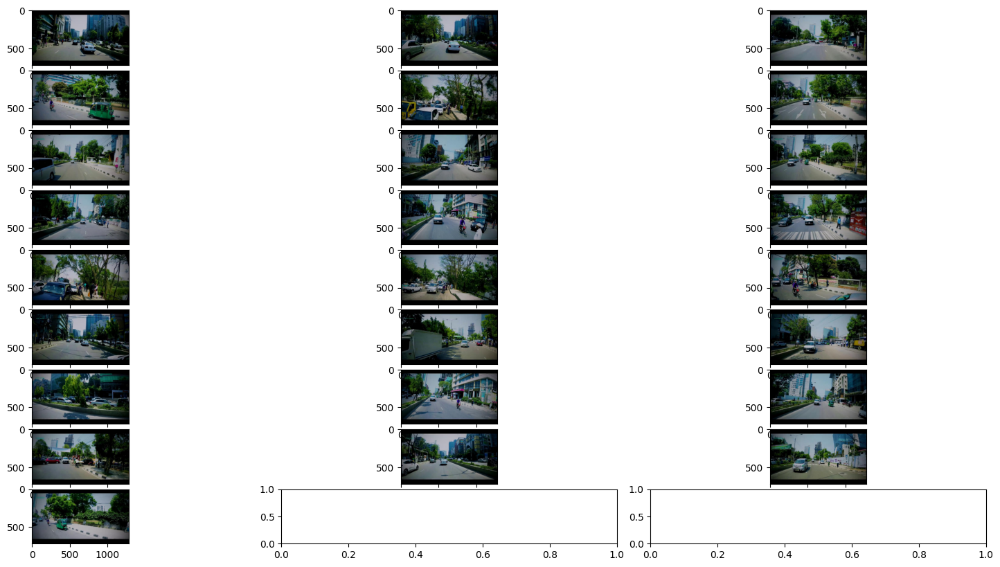

In [5]:
visualize(images, column=3, fig_size=(20,10))

#### Checking out the brighten function


### brighten

**parameters**

**image:** image or image list

**brightness_coeff** amount of brightness (0<=brightness_coeff<=1), default: random

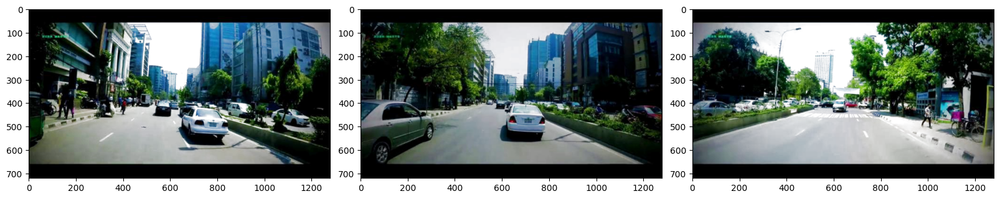

In [6]:
bright_images= brighten(images[0:3]) ## if brightness_coeff is undefined brightness is random in each image
visualize(bright_images, column=3)

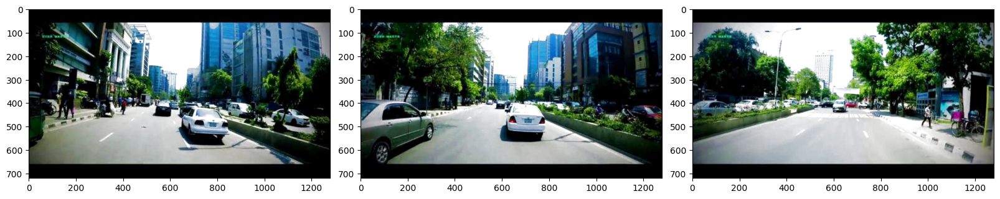

In [7]:
bright_images= brighten(images[0:3], brightness_coeff=0.7) ## brightness_coeff is between 0.0 and 1.0
visualize(bright_images, column=3)


#### Let's darken a few images now

### darken

**parameters**

**image:** image or image list

**darkness_coeff** amount of darkness (0<=darkness_coeff<=1), default: random

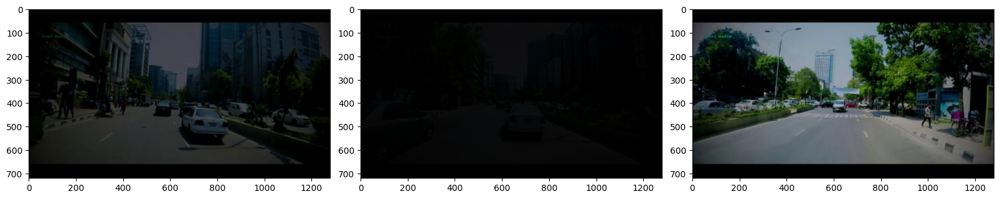

In [8]:
dark_images= darken(images[0:3]) ## if darkness_coeff is undefined darkness is random in each image
visualize(dark_images, column=3)

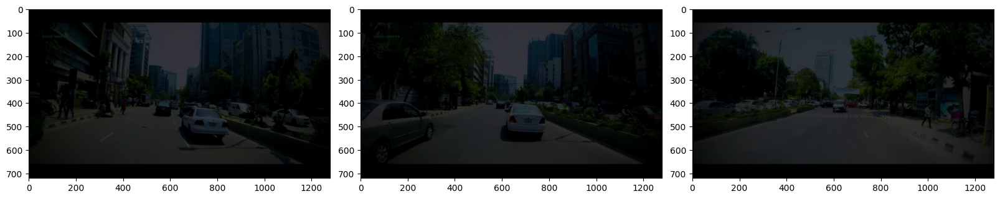

In [9]:
dark_images= darken(images[0:3], darkness_coeff=0.7) ## darkness_coeff is between 0.0 and 1.0
visualize(dark_images, column=3)

#### But what if you just want some random brightness or darkness in the images. Well try out the random_brightness function which receives an image or an image array


### random_brightness

**parameters**

**image:** image or image list

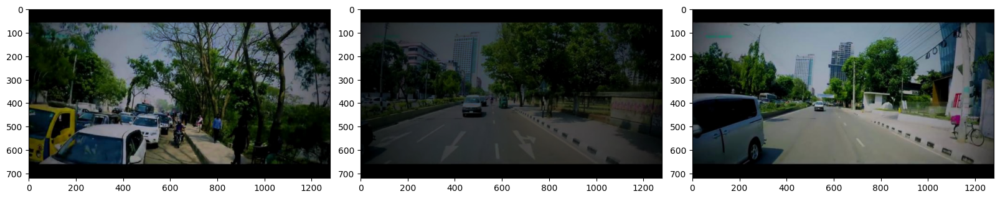

In [10]:
dark_bright_images= random_brightness(images[4:7])
visualize(dark_bright_images, column=3)


#### What about adding some shadows to the images.

### add_shadow

**Parameters**

**image:** image or image list

**no_of_shadows:** no. of shadows, **default:** 1

**rectangular_roi:** (top-left x, top-left y, bottom-right x, bottom right y), **default:** lower half of image

**shadow_dimension:** no. of sides of the shadows (3<=shadow_dimension<=10), **default:** random

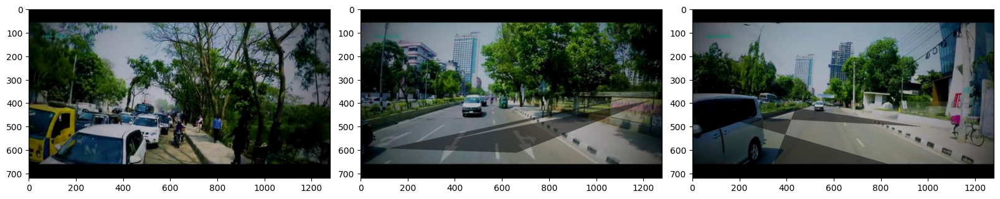

In [11]:
shadowy_images= add_shadow(images[4:7])
visualize(shadowy_images, column=3)


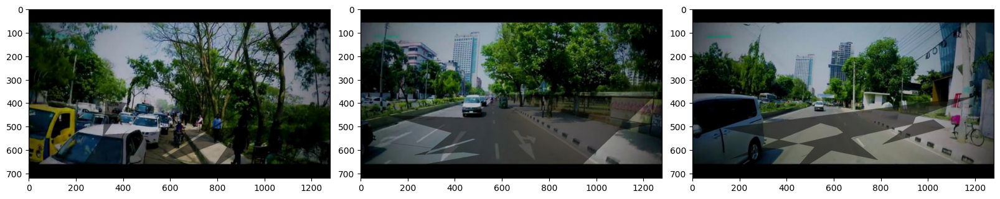

In [12]:
shadowy_images= add_shadow(images[4:7], no_of_shadows=2, shadow_dimension=8)
visualize(shadowy_images, column=3)

#### Now let's add some snow

### add_snow

**parameters**

**image:** image or image list

**snow_coeff:** amount of snow (0<=snow_coeff<=1), **default:** random

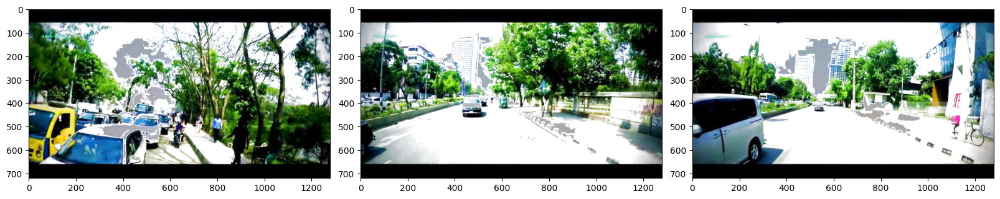

In [13]:
snowy_images= add_snow(images[4:7]) ##randomly add snow
visualize(snowy_images, column=3)

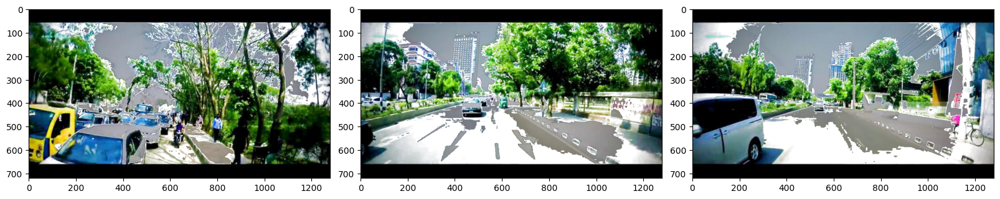

In [14]:
snowy_images= add_snow(images[4:7], snow_coeff=0.3)
visualize(snowy_images, column=3)

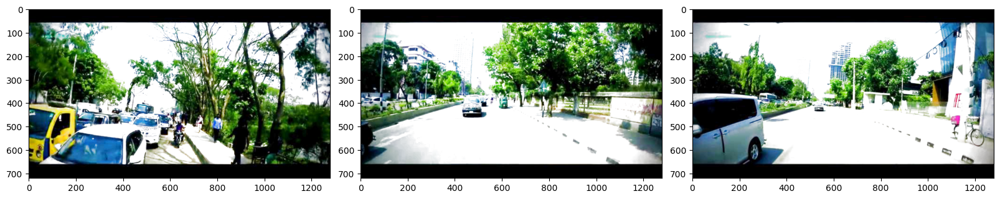

In [15]:
snowy_images= add_snow(images[4:7], snow_coeff=0.8)
visualize(snowy_images, column=3)

#### and now some rain

### add_rain

**parameters**


**image:** image or image list

**slant:** deviation of rain from normal (-20<=slant<=20), **default:** random

**drop_length:** length of the drop (0<=drop_length<=100), **default:** 20 (pixels)

**drop_width:** width of the drop (1<=drop_width<=5), **default:** 1

**drop_color:** color of droplets, **default:** (200,200,200)

**rain_type:** values in 'drizzle','heavy','torrential', **default:** 'None'

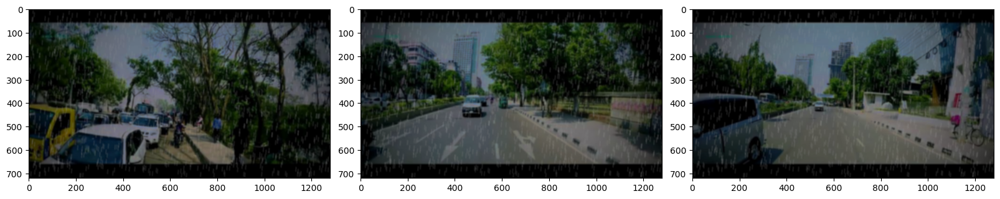

In [16]:
rainy_images= add_rain(images[4:7])
visualize(rainy_images, column=3)

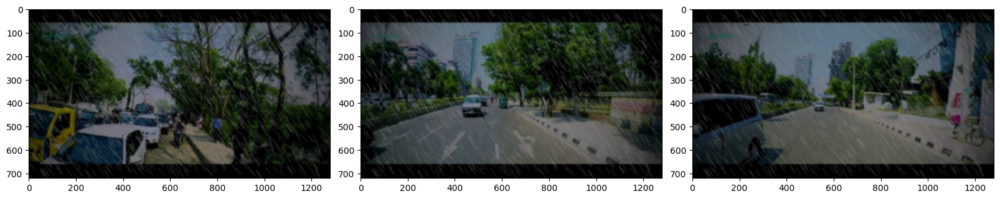

In [17]:
rainy_images= add_rain(images[4:7], rain_type='heavy', slant=20)
visualize(rainy_images, column=3)

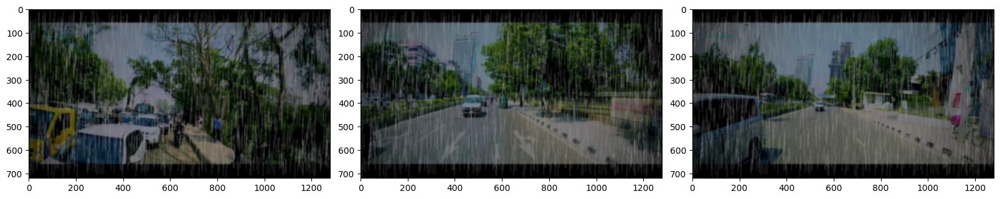

In [18]:
rainy_images= add_rain(images[4:7], rain_type='torrential')
visualize(rainy_images, column=3)

**Note:** drop_length and drop_width values are overriden when rain_type is not None

### add_fog

**parameters**

**image**: image or image list

**fog_coeff:** amount of fog (0<=fog_coeff<=1), **default:** random

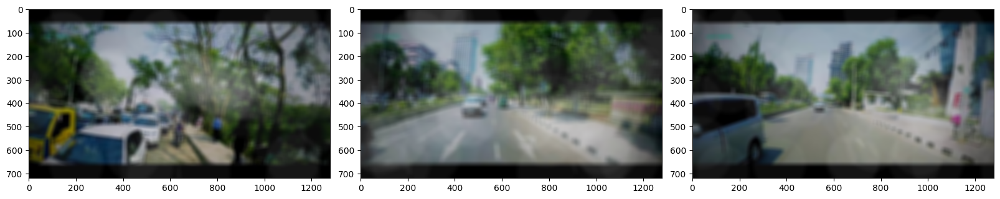

In [19]:
foggy_images= add_fog(images[4:7])
visualize(foggy_images, column=3)

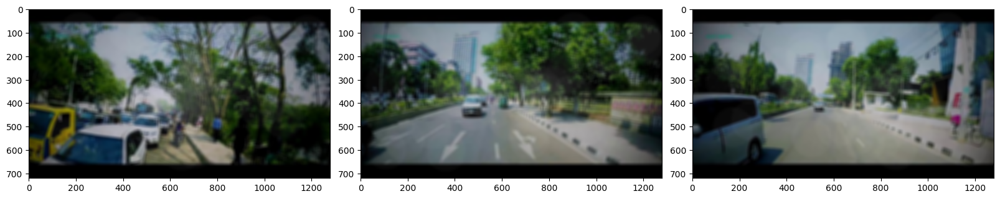

In [20]:
foggy_images= add_fog(images[4:7], fog_coeff=0.4)
visualize(foggy_images, column=3)

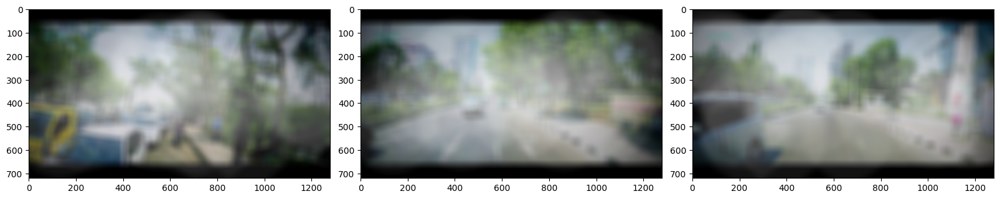

In [21]:
foggy_images= add_fog(images[4:7], fog_coeff=0.9)
visualize(foggy_images, column=3)

#### what about some gravels on the road now ?

### add_gravel

**parameters**

**image:** image or image list

**rectangular_roi:** (top-left x, top-left y, bottom-right x, bottom right y), **default:** lower 3/4th of image

**no_of_patches:** no. of gravel patches required, **default:** 8

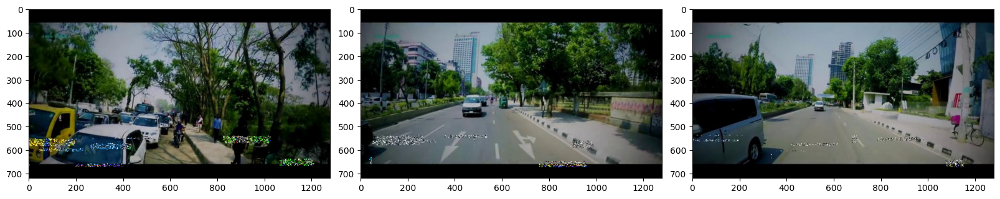

In [22]:
bad_road_images= add_gravel(images[4:7])
visualize(bad_road_images, column=3)

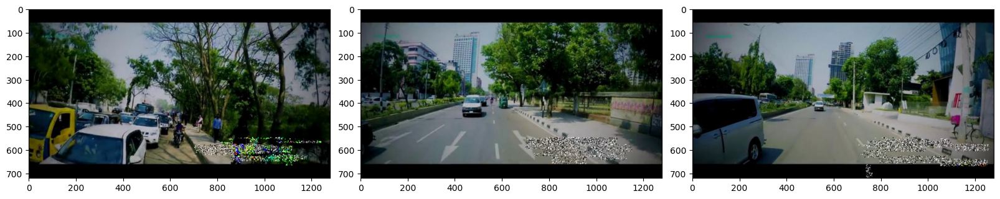

In [23]:
bad_road_images= add_gravel(images[4:7], rectangular_roi=(700,550,1280,720),no_of_patches=20) ##too much gravels on right
visualize(bad_road_images, column=3)

### add_sun_flare

**parameters**

**image:** image or image list

**flare_center:** center coordinates (x,y) of the source, **default:** random

**angle:** angle of flare in randians, **default:** random

**no_of_flare_circles:** no. of secondary flare circles (0<=no_of_flare_circles<=20), **default:** 8

**src_radius:** radius of the primary flare source, **default:** 400 (pixels)

**src_color:** rgb color of the flare source and secondary circles, **default:** (255,255,255))

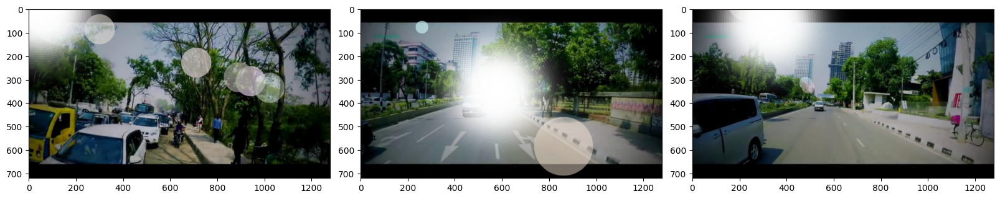

In [24]:
flare_images= add_sun_flare(images[4:7])
visualize(flare_images, column=3)

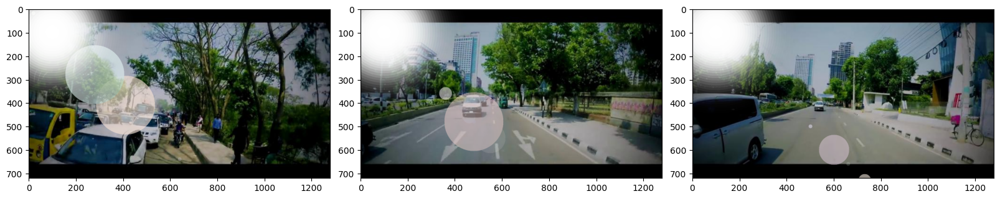

In [25]:
import math
flare_images= add_sun_flare(images[4:7], flare_center=(100,100), angle=-math.pi/4) ## fixed src center
visualize(flare_images, column=3)

### add_speed

**parameters**

**image:** image or image list

**speed_coeff:** amount of speed (0<=speed_coeff<=1), default: random

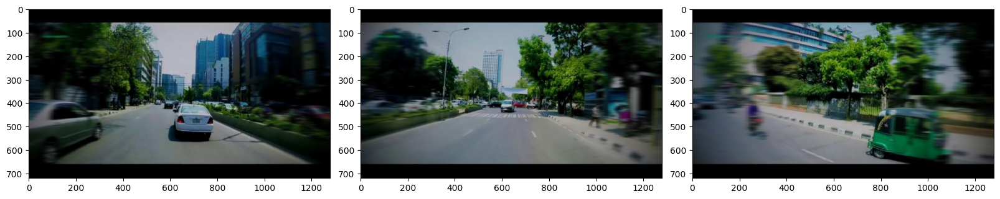

In [26]:
speedy_images= add_speed(images[1:4]) ##random speed
visualize(speedy_images, column=3)

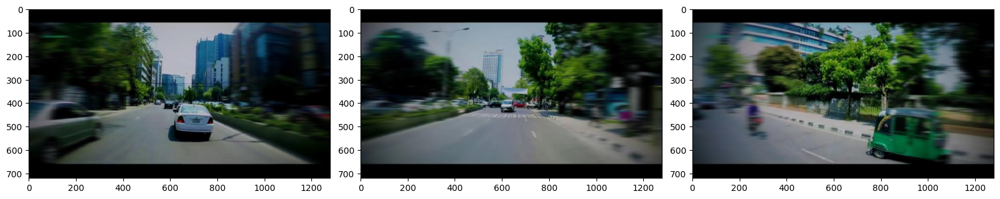

In [27]:
speedy_images= add_speed(images[1:4], speed_coeff=0.9) ##random speed
visualize(speedy_images, column=3)

### add_autumn

**parameters**

image: image or image list

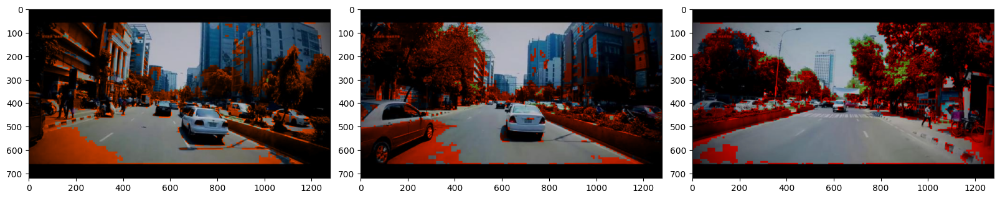

In [28]:
fall_images= add_autumn(images[0:3])
visualize(fall_images, column=3)

### fliph

**parameters**

image: image or image list

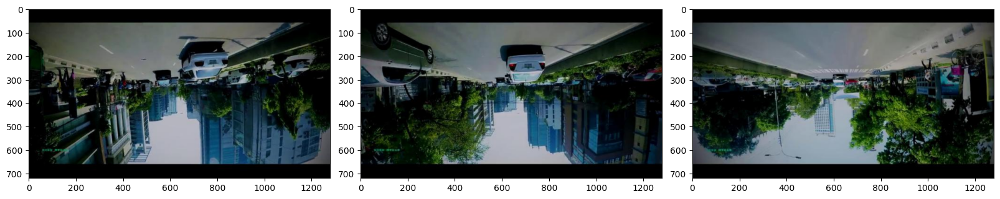

In [29]:
flipped_images= fliph(images[0:3])
visualize(flipped_images, column=3)

### flipv

**parameters**

image: image or image list

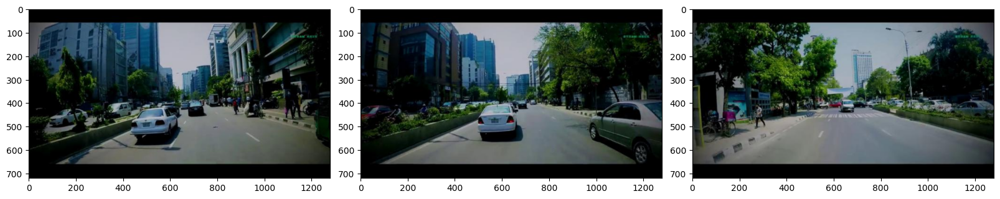

In [30]:
flipped_images= flipv(images[0:3])
visualize(flipped_images, column=3)

### random_flip

**parameters**

image: image or image list

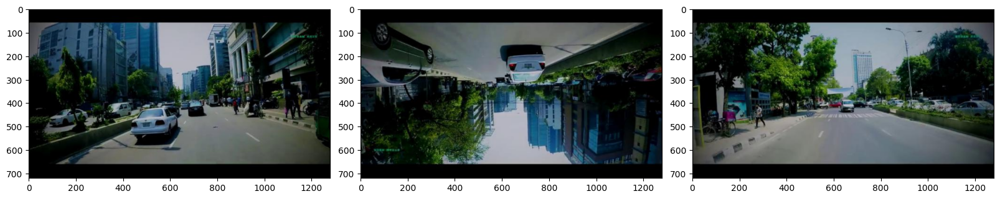

In [31]:
flipped_images= random_flip(images[0:3])
visualize(flipped_images, column=3)

### add_manhole

**parameters**

**image:** image or image list

**center:** center of the ellipse (x,y), default: bottom center of the image

**color:** rgb tuple, default: if type parameter not defined: (67,70,75), else: default color mentioned in type.

**height** vertical dimension of the hole, int , default: 25th portion of the image height.

**width:** horizontal dimension of the hole, int, default: 3/25th portion of the image height.

**type:** values in 'closed','open', default: 'closed'
                                  

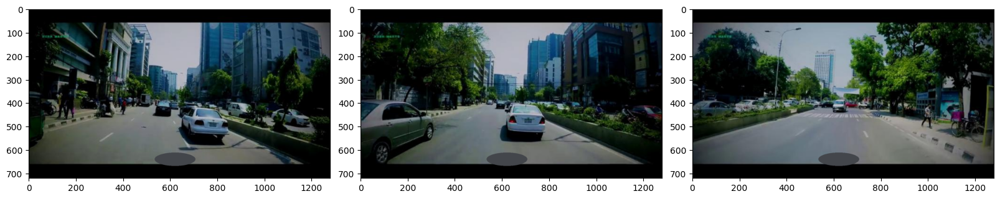

In [32]:
manhole_images= add_manhole(images[0:3])
visualize(manhole_images, column=3)


#### If a series of augmentations is required from above types augment_random function can be handy

### augment_random

**image:** image or image list

**aug_types:** list of Automold functions, eg: ['add_snow','add_rain'], **default:** all aug functions are executed

**volume:** 'same' or 'expand', **default:** expand

            same: keeps the volume of corpus unchanged, applies random aug_types on images

            expand: applies all aug_types on all images and expands output corpus

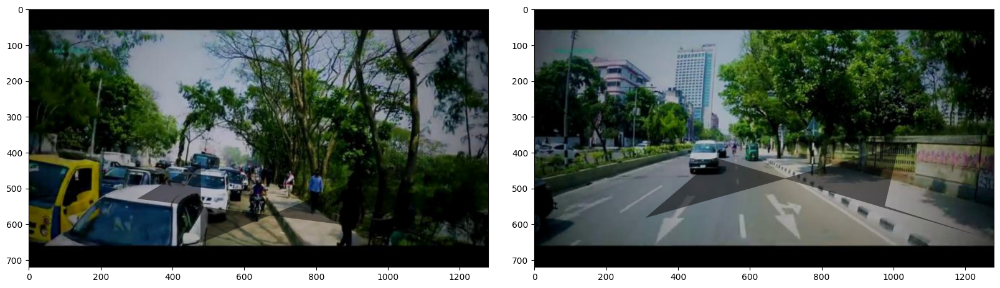

In [33]:
aug_images= augment_random(images[4:6], volume='same')  ##2 random augmentations applied on both images
visualize(aug_images,column=3,fig_size=(20,20))

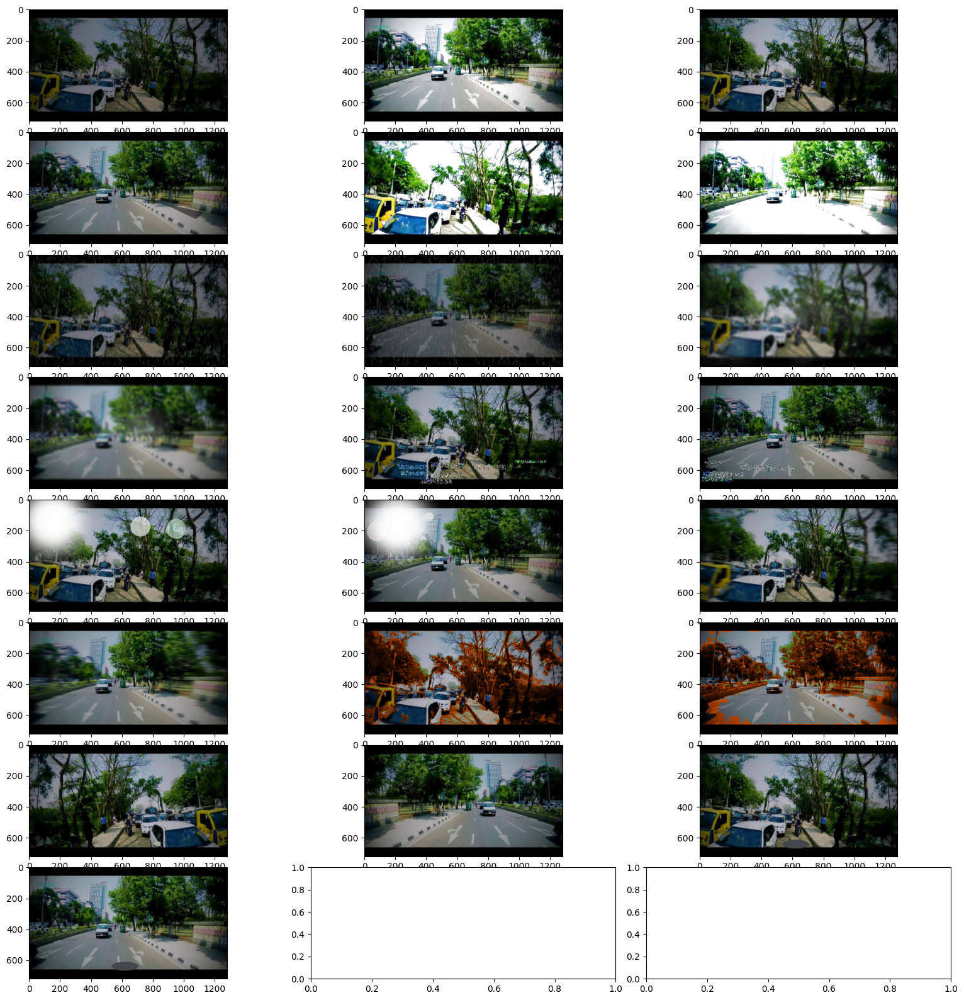

In [34]:
aug_images= augment_random(images[4:6], volume='expand')  ##all aug_types are applied in both images
visualize(aug_images,column=3,fig_size=(20,20))

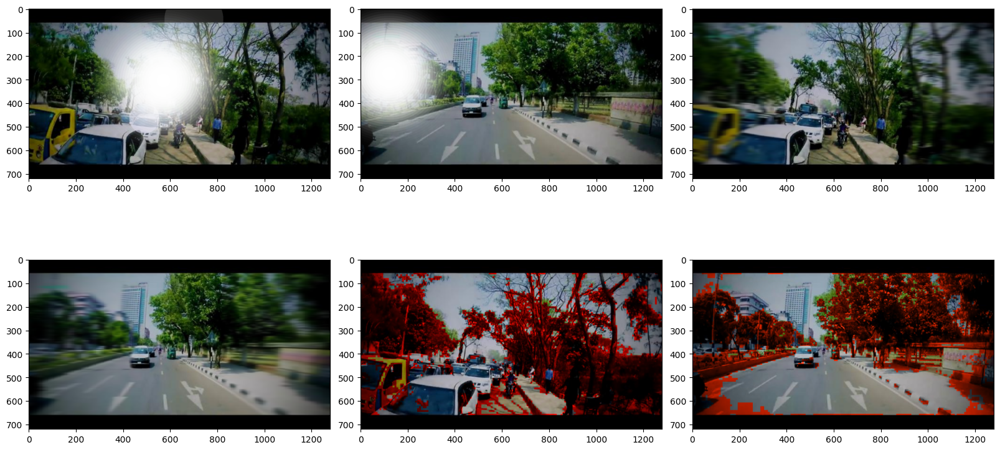

In [35]:
aug_images= augment_random(images[4:6], aug_types=['add_sun_flare','add_speed','add_autumn'], volume='expand')  ##all aug_types are applied in both images
visualize(aug_images,column=3,fig_size=(20,10))

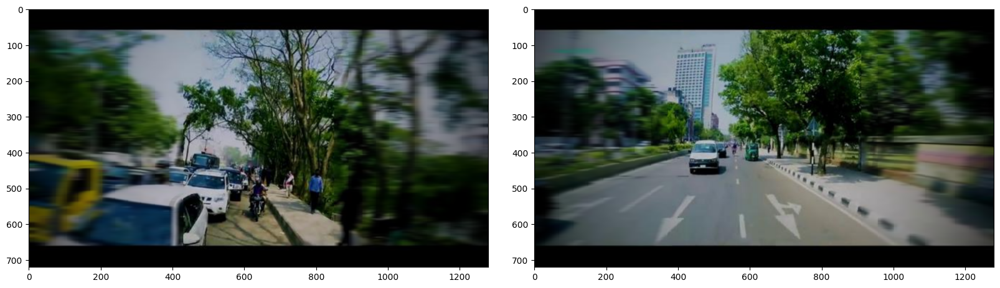

In [36]:
aug_images= augment_random(images[4:6], aug_types=['add_sun_flare','add_speed','add_autumn'], volume='same')  ##2 random aug_types are applied in both images
visualize(aug_images,column=3,fig_size=(20,10))

#### Performance statistics

In [38]:
aug_types=["random_brightness","add_shadow","add_snow","add_rain","add_fog","add_gravel","add_sun_flare","add_speed","add_autumn","random_flip","add_manhole"]
dict_time={}
import time
for aug_type in aug_types:
    t=time.time()
    command=aug_type+'(images)'
    result=eval(command)
    dict_time[aug_type]=time.time()-t
    t=time.time()
print('Average Time taken per augmentaion function to process 1 image:')
tot=0
for key, value in dict_time.items():
    tot+=value
    print(key, '{0:.2f}s'.format(value/len(images)))

print('-----------------------')
print('Total no. of augmented images created:', len(aug_types)*len(images))
print('-----------------------')
print('Total time taken to create ',len(aug_types)*len(images),' augmented images:', '{0:.2f}s'.format(tot))

Average Time taken per augmentaion function to process 1 image:
random_brightness 0.05s
add_shadow 0.03s
add_snow 0.06s
add_rain 0.02s
add_fog 0.12s
add_gravel 0.04s
add_sun_flare 0.05s
add_speed 0.22s
add_autumn 0.22s
random_flip 0.00s
add_manhole 0.00s
-----------------------
Total no. of augmented images created: 275
-----------------------
Total time taken to create  275  augmented images: 20.02s


In [39]:
#Loader adapted with no resize, Image 3 in repo will not work without resize.
image_list = []
images = glob.glob(path)
for index in range(len(images)):
    print(images[index])
    image= cv2.cvtColor(cv2.imread(images[index]),1)
    #image_list.append(cv2.resize(image,(1280,720)))
    image_list.append(image)

    # Apply rain or other augmentation
    rain_image= add_rain(image)

    # Uncomment to show image
    #cv2.imshow(images[index], flare_rain_imageimages)
    #cv2.waitKey(0)

    # Save image
    cv2.imwrite(images[index].replace('.jpg', '_rain.jpg'),rain_image)

/content/test/Pias--71-_jpg.rf.b36acff3275b25acc780399a74404bb7.jpg
/content/test/Pias--69-_jpg.rf.ed0d8e0f499c15319381b293cac1923d.jpg
/content/test/Pias--63-_jpg.rf.2a61f476c3b0ad129da2f5821b493c05.jpg
/content/test/Pias--57-_jpg.rf.b9c1ac0d305a93cf3542fecce50bc5f9.jpg
/content/test/Pias--8-_jpg.rf.2b0308c8608ff55c6793d83200b00543.jpg
/content/test/Pias--60-_jpg.rf.9e63546bb9a48b0915789acd375162d3.jpg
/content/test/Pias--64-_jpg.rf.941e35f1b9256a0856f34ceb41ab09ac.jpg
/content/test/Pias--51-_jpg.rf.fe0aedcd0721cc680c50ebb55917fa0e.jpg
/content/test/Pias--59-_jpg.rf.d408b6cc7c660870a9307ad3b6437fa1.jpg
/content/test/Pias--53-_jpg.rf.3cf3beb96d3e3147a32f9e13133e9ecb.jpg
/content/test/Pias--55-_jpg.rf.20eed826bded1c331cb706768ca70ebe.jpg
/content/test/Pias--61-_jpg.rf.6dc9fd201edce7a57c060a26eb871c1c.jpg
/content/test/Pias--7-_jpg.rf.ea09402c4e07c6e8f8054e402813ce38.jpg
/content/test/Pias--9-_jpg.rf.9424ed79735184aaa780764416e7a2e3.jpg
/content/test/Pias--56-_jpg.rf.1612f733e09c9ef1c916

**Note:** The load_images helper function resizes all images to 1280x720 and thus all returned images have the same dimensions. If original image dimensions are required please write a new load function

Some more helpful functions are in pipeline and will get added to the library asap.
Thanx